In [210]:
import pandas as pd
import plotly.graph_objs as go
import plotly.express as px
import plotly.subplots as sp
import plotly.io as pio
import plotly.offline as py
from plotly.subplots import make_subplots
import numpy as np
import string
import matplotlib.pyplot as plt

# Nutrition & Health: Balance Between Individual Disparities and Personal Responsibility

##### Student names: Lo van der Naaten, Dylan Nowee, Simon Veening, Wouter Westerhof <br> Group number: P4

In [211]:
url = 'https://ichef.bbci.co.uk/news/976/cpsprodpb/102FB/production/_124399266_gettyimages-dv1554016.jpg.webp'
from IPython.display import Image, display
width = 600
height = 300
image = Image(url=url, width=600, height=300)
display(image)

## Introduction

Diabetes and obesity are growing problems in today's society. Unhealthy eating habits and inconsistent diets are creating an overall decline in people's general health. These behaviors can be traced back to multiple causes. The goal of this data research is to investigate the complex interplay between these causes. Using two complete and extensive datasets, we will examine the different correlations that can be made between the consumers’ diet, health and multiple outer factors, like income levels and food prices. Further numbers we will analyze include, for example, physical activity levels, addictions and education.

The ultimate goal of this research is to shed light on the nature and reasoning behind people's choices regarding diet and health, in order to perhaps develop strategies to improve the public's overall health.

## Datasets & Preprocessing

The main dataset that we will be using for our project is called 'Diabetes Health Indicators Dataset', derived from the Behavioural Risk Factor Surveillance System (BRFSS) which is a yearly survey regarding health, published by the CDC. Our dataset is from the year 2015. It consists of answers from 253,680 individuals, including risk behaviors, health issues, eating / drug habits, etc. The dataset is from a zip file containing three datasets total, but our focus will be on “diabetes_binary_health_indicators_BRFSS2015”, which categorizes the presence of diabetes into two simple categories; those with diabetes, and those without. These numbers, in combination with the different variables from the survey responses regarding health and diet, will aid us in finding the answers of our questions perfectly.

In [212]:
df1 = pd.read_csv('diabetes_binary_health_indicators_BRFSS2015.csv')

The secondary dataset used in this research, 'Food Prices in Turkey', consists of the average prices of different kinds of whole foods in Turkey throughout the years. Although its data is not from the United States of America as with the main database, the data is clean and complete, and can still be preprocessed to fit our research as best as possible. For instance, the data from this dataset that does not originate from the year 2015 can be filtered out, so that the remaining data is from the same year as in our main dataset.

In [213]:
raw_db_turkey = pd.read_csv("train.csv")
db_turkey = raw_db_turkey[raw_db_turkey['Year']==2015]

The data from our newly preprocessed dataset now only includes data from 2015, just like our main dataset. Furthermore, designating the different foods within the dataset to their respective food categories results in the following list of categories:

- Grains & Potatoes (Rice, Wheat flour, Pasta, Bulgur, Bread (common), Bread (pita), Potatoes) --> carbohydrates

- Legumes (Beans (white), Lentils, Chickpeas, Peas (green, dry)) --> carbohydrates / proteins

- Fruits & Vegetables (Apples (red), Bananas, Oranges, Tomatoes, Garlic, Onions, Cabbage, Cauliflower, Cucumbers (greenhouse), Spinach, Eggplants) --> vitamines / fibers

- Meats (Meat (chicken), Meat (mutton), Meat (veal), Fish (fresh)) --> proteins

- Dairy (Milk (pasteurized), Yogurt, Cheese) --> fats / proteins

- Sugar --> carbohydrates

## Perspective 1: Income Disparities and Nutritional Inequality

One of the most prominent causes of nutritional inequality is income inequality. Through examination of incomes and food prices, our aim is to expose and display the cause-effect relationship between economic factors and the differential access to various food categories. By comparing certain statistics on food prices with the recommended consumption of each food category, our hope is to uncover economic factors that contribute to divergent dietary patterns. These results might lead to potential conclusions, which could help with finding solutions to prominent health risks in today's society.

#### Prices vs. Recommended consumption

As mentioned above, the whole foods from our dataset 'Food Prices in Turkey' were categorized into certain food groups: grains & potatoes, legumes, fruits & vegetables, meats, dairy and sugar. According to the WHO, a healthy diet should consist of different amounts of calories from all categories. Grain & potatoes are a great source of carbohydrates, for example, whilst meats and dairy are important sources of protein. Obesity and diabetes are often caused by overconsumption of carbohydrates. Putting the average food prices in 2015 together with recommended food consumption can be visualized as such:

In [214]:
data_barchart = {
    "Categories": ["Grains & Carbs", "Grains & Carbs", "Grains & Carbs", "Grains & Carbs", "Grains & Carbs", "Grains & Carbs", "Grains & Carbs",
                   "Legumes", "Legumes", "Legumes", "Legumes",
                   "Fruits & Vegetables", "Fruits & Vegetables", "Fruits & Vegetables", "Fruits & Vegetables", "Fruits & Vegetables", "Fruits & Vegetables", "Fruits & Vegetables", "Fruits & Vegetables", "Fruits & Vegetables", "Fruits & Vegetables", "Fruits & Vegetables",
                   "Meats", "Meats", "Meats", "Meats",
                   "Dairy", "Dairy", "Dairy", "Sugar"],
    "Subcategories": ["Rice", "Wheat flour", "Pasta", "Bulgur", "Bread (common)", "Bread (pita)", "Potatoes",
                      "Beans (white)", "Lentils", "Chickpeas", "Peas (green, dry)",
                      "Apples (red)", "Bananas", "Oranges", "Tomatoes", "Garlic", "Onions", "Cabbage", "Cauliflower", "Cucumbers (greenhouse)", "Spinach", "Eggplants",
                      "Meat (chicken)", "Meat (mutton)", "Meat (veal)", "Fish (fresh)",
                      "Milk (pasteurized)", "Yogurt", "Cheese", "Sugar"],
    "Prices": [6.43, 2.67, 2.94, 2.68, 2.98, 2.31, 1.54,
               7.29, 5.79, 5.67, 3.17,
               2.4, 5.37, 1.71, 1.93, 10.94, 1.38, 1.2, 2.77, 1.98, 2.66, 1.92,
               7.02, 27.0, 33.12, 14.09,
               2.82, 3.98, 15.42, 3.85]
}

data_piechart = {
    "Categories": ["Grains & Carbs", "Legumes", "Fruits & Vegetables", "Meats & Other", "Dairy", "Sugar"],
    "Total averages": [3.24, 6.01, 3.45, 16.32, 6.53, 3.85],
    "Ideal Percentages": [20, 20, 50, 15, 15, 5],
    "Colors": ["yellow", "brown", "green", "red", "lightblue", "orange"]
}

df_bar = pd.DataFrame(data_barchart)
df_pie = pd.DataFrame(data_piechart)

color_map1 = {
    "Grains & Carbs": "rgb(230, 230, 0)",
    "Legumes": "rgb(140, 35, 35)",
    "Fruits & Vegetables": "rgb(0, 100, 0)",
    "Meats": "rgb(200, 0, 0)",
    "Dairy": "rgb(150, 190, 200)",
    "Sugar": "rgb(200, 130, 0)"
}

color_map2 = {
    "Grains & Carbs": "rgb(255, 255, 0)",
    "Legumes": "rgb(165, 42, 42)",
    "Fruits & Vegetables": "rgb(0, 128, 0)",
    "Meats": "rgb(255, 0, 0)",
    "Dairy": "rgb(173, 216, 230)",
    "Sugar": "rgb(255, 165, 0)"
}

df_mean = df_bar.groupby("Categories")["Prices"].mean().reset_index()

scatter_fig = go.Figure()

for category, color in color_map1.items():
    category_data = df_bar[df_bar["Categories"] == category]
    scatter_fig.add_trace(
        go.Scatter(
            x = category_data["Categories"],
            y = category_data["Prices"],
            mode = "markers",
            marker = dict(
                color = color,
                symbol = "circle",
                size = 8,
                opacity = 0.75,
                line = dict(color = "#000000", width = 1)
            ),
            name = category,
            hovertemplate = "%{text}<extra></extra>",
            text = category_data["Subcategories"]
        )
    )

bar_fig = go.Figure()

for category, color in color_map2.items():
    category_mean = df_mean[df_mean["Categories"] == category]
    bar_fig.add_trace(
        go.Bar(
            x = category_mean["Categories"],
            y = category_mean["Prices"],
            marker = dict(
                color = color,
            ),
            name = f"{category} (Mean)",
        )
    )

combined_fig = go.Figure(data = scatter_fig.data + bar_fig.data)

combined_fig.update_layout(
    title = "Average Prices of Different Foods in the USA, 2015",
    barmode = "overlay",
    xaxis = {"title": "Food Categories"},
    yaxis = {"title": "Average Price in 2015 ($ per kg)"},
    height = 500,
    width = 1072,
    showlegend = False
)

combined_fig.show()

pie_fig = go.Figure()

pie_fig.add_trace(
    go.Pie(labels = df_pie["Categories"], values = df_pie["Ideal Percentages"], textfont_size = 14, insidetextorientation='radial', marker = dict(colors = df_pie["Colors"], line = dict(color = "#000000", width = 1)))
)

pie_fig.update_layout(
    title = "Recommended Nutrition per Food Category",
    height = 500,
    width = 1072
)

pie_fig.show()

The most notable statistic from this visualization is the high cost of meat, which is a main source of protein for many. Other sources of proteins and healthy fats such as dairy and legumes are also more expensive than most sources of carbohydrates. Carbohydrates like pasta, potatoes and direct sugars are often eaten in abundance by people who are considered unhealthy. When viewing the recommended nutrition of all food categories, it is significant how carbohydrates and especially sugars should be eaten with some sort of moderation. Prices of vegetables and fruits are fortunately relatively low, but as mentioned before, this data regards whole foods only. Particularly in the USA, processed foods tend to become more expensive with a more 'healthy image', whereas junk food prices remain the same. 

#### Income and Health compared

The impact of economics on dietary habits can also directly be derived from comparing the two fields. This way, all foods are taken into consideration, so also processed foods such as junk food and premade meals. Using main dataset 'Diabetes Health Indicators Dataset', a comparison between the subjects' health and their share of incomes can be pleasantly visualized. 
For analysis of the participants' BMI's in this dataset, they can be aggregated into 4 different categories. These categories were established to conform to the statistics of the WHO as follows:
- Underweight: BMI < 18.5
- Healthy weight: 18.5 < BMI < 25.0
- Overweight: 25.0 < BMI < 30.0
- Obese: BMI > 30.0

Using these specifications, our dataset makes for the following graph:

In [215]:
df1['bmi_qcut'] = pd.qcut(df1['BMI'], q=5, labels=False)

cutoff=[0, 18.5, 25, 30, 999]
labels=['Underweight', 'Healthy weight', 'Overweight', 'Obese']
cut_bmi, cut_bmi_bins = pd.cut(df1['BMI'], bins=cutoff, labels=labels, retbins=True)
df1['cut_bmi'] = cut_bmi

bmi_counts = df1['cut_bmi'].value_counts()

bmi_percentage = bmi_counts / len(df1) * 100

colors = ['yellow', 'green', 'red', 'blue']

fig3 = go.Figure(go.Pie(values=bmi_percentage, labels=bmi_counts.index, marker=dict(colors=colors, line=dict(color='#000000', width=1))))
fig3.update_layout(
    title='Distribution of BMI Categories',
    width=1072
)

fig3.show()

This graph shows that over 2/3 of citizens in the USA are overweight, of which half suffer from obesity. Besides the fact that this graph proves our point of the importance of the subject we are discussing, it also gives us a clear view of the distribution of BMI's in the USA.

We can now consider any correlations between BMI and average income. It is important to note that this dataset defines a scale of eight different annual income groups, where 1 = less than $10,000, 5 = less than $35,000 and 8 = $75,000 or more. If we put these numbers together, we get the following graph:

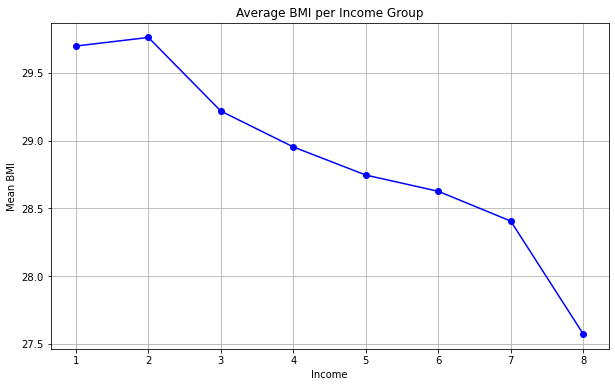

In [216]:
mean_bmi_by_income = df1.groupby('Income')['BMI'].mean()

plt.figure(figsize=(10, 6))
mean_bmi_by_income.plot(kind='line', marker='o', color='blue')
plt.xlabel('Income')
plt.ylabel('Mean BMI')
plt.title('Average BMI per Income Group')
plt.grid(True)
plt.show()

There is a surprisingly linear correlation between the average BMI's of American citizens and their average incomes. The higher the income, the lower the BMI. This supports the theory that people with a higher income are more likely to purchase healthier foods. It is evident that, as poverty is more apparent, the availability of healthier foods decreases. It would seem that poor dietary decisions are not a matter of choice, but rather a matter of income. Better diets might be promoted by the lowering of the prices of healthier foods. The overconsumption of junk food and other unhealthy (processed) foods can be disencouraged by perhaps applying a tax on these foods. 

#### BMI and Education

The first indirect cause of unhealthy nutrition behavior that can be analyzed is education. It is important to note that, as with income, our main dataset defines a scale of 6 different education levels, where 1 = Never attended school or only kindergarten 2 = Grades 1 through 8, etc. When visualizing the public's health and education levels, we get the following graph:

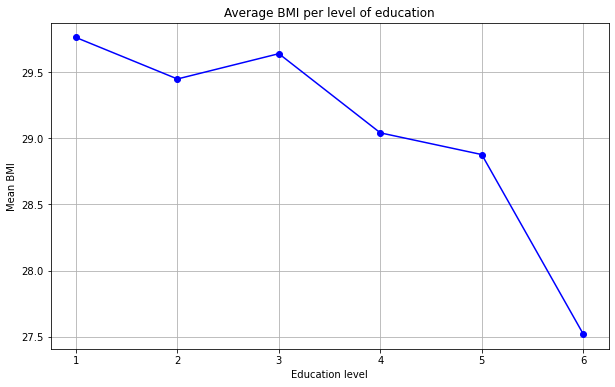

In [217]:
mean_bmi_by_education = df1.groupby('Education')['BMI'].mean()

plt.figure(figsize=(10, 6))
mean_bmi_by_education.plot(kind='line', marker='o', color='blue')
plt.xlabel('Education level')
plt.ylabel('Mean BMI')
plt.title('Average BMI per level of education')
plt.grid(True)
plt.show()

There are two interpretations of this graph. Again, there is an obvious correlation between the two fields; the higher the education level, the lower the average BMI. This could mean that people with a higher level of education are more aware of the choices they make regarding their diet. Higher education would lead to smarter choices and therefore a healthier diet. 

A second interpretation is that higher education leads to better jobs. People who are better educated, have better possibilities in the job market, and are therefore able to make more money. This interpretation would be in support of our previous argument regarding the effect of income inequality on dietary habits.

## Perspective 2: Personal Responsibility and Imbalanced Diets

Within our second perspective, we focus on the role of personal responsibility in shaping healthier dietary choices. For this perspective, other data regarding more personal choices and secondary factors can be used, such as physical activity, drug usage and food choices. With this information, we might find correlations between everyday habits and overall health outcomes. We will analyze these correlations and visualize them, which could help in finding effective methods of improving society’s overall health with not just nutrition policies, but perhaps also through other, second-hand means that may be overlooked on the first instance.

#### Addictions and Overall Health

We recognize the significance of secondary factors that influence dietary habits. By analyzing data that pertains to personal choices and habits, we gain a deeper understanding of how these factors intertwine and shape overall health outcomes. One aspect we explore is the subject of addictions like smoking and drinking, and if they have any correlations with bad dietary habits. By observing these correlations, underlying questions can be answered. Do individuals who engage in addictive behaviors neglect healthy eating habits more often? Or do these unhealthy habits not tell us anything about likeliness of unhealthy diets? This analysis can shed light on psychological and personal influence on diet composition.

In [218]:
overlap_count = ((df1['Diabetes_binary'] == 1) & (df1['Smoker'] == 1)).sum()
overlap_count_healthy = ((df1['Fruits'] == 1) & (df1['Smoker'] == 1) & (df1['Veggies'] == 1)).sum()
overlap_count_unhealthy = ((df1['HighChol'] == 1) & (df1['Smoker'] == 1)).sum()
amount_of_smokers = (df1['Smoker'] == 1).sum()
amount_of_nonsmokers = (df1['Smoker'] == 0).sum()

column1_count = df1['Diabetes_binary'].sum()
column2_count = df1['Fruits'].sum()
column3_count = df1['Smoker'].sum()
column5_count = df1['HighChol'].sum()
                      
overlap_percentage = (overlap_count / column1_count) * 100
percentage_smokers = (amount_of_smokers / column3_count) * 100
overlap_percentage_healthy = (overlap_count_healthy / column2_count) * 100
overlap_percentage_unhealthy = (overlap_count_unhealthy / column5_count) * 100


fig = px.pie(
    values=[overlap_percentage, 100-overlap_percentage],
    names=['Smokes', 'Does not smoke'],
    title='Percentage of diabetes patients that smoke'
)
fig2 = px.pie(
    values = [amount_of_smokers, amount_of_nonsmokers],
    names=['Smokes', 'Does not smoke'],
    title='Percentage of all people that smoke'
)
 
fig3 = px.pie(
    values=[overlap_percentage_healthy, 100 - overlap_percentage_healthy],
    names=['Smokes', 'Does not smoke'],
    title='Percentage of healthy eaters that smoke'
)

fig4 = px.pie(
    values=[overlap_percentage_unhealthy, 100 - overlap_percentage_unhealthy],
    names=['Smokes', 'Does not smoke'],
    title='Percentage of unhealthy eaters that smoke'
)


fig.show()
fig3.show()
fig4.show()
fig2.show()

conclusie slechte eetgewoonten tegenover andere slechte gewoonten (roken, drinken)

#### Total comparison 

totale visualisatie gewoonten tegenover meerdere health indicators:

In [219]:
conditions = [
    (df1['Fruits'] == 1) & (df1['Veggies'] == 1) & (df1['HvyAlcoholConsump'] == 0),
    (df1['Fruits'] == 1) & (df1['Veggies'] == 1) & (df1['HvyAlcoholConsump'] == 1),
    (df1['Fruits'] == 1) & (df1['Veggies'] == 0) & (df1['HvyAlcoholConsump'] == 1),
    (df1['Fruits'] == 1) & (df1['Veggies'] == 0) & (df1['HvyAlcoholConsump'] == 0),
    (df1['Fruits'] == 0) & (df1['Veggies'] == 1) & (df1['HvyAlcoholConsump'] == 0),
    (df1['Fruits'] == 0) & (df1['Veggies'] == 1) & (df1['HvyAlcoholConsump'] == 1),
    (df1['Fruits'] == 0) & (df1['Veggies'] == 0) & (df1['HvyAlcoholConsump'] == 1),
    (df1['Fruits'] == 0) & (df1['Veggies'] == 0) & (df1['HvyAlcoholConsump'] == 0)
]

values = [
    'Fruits+Veggies+no_hvy_alcohol',
    'Fruits+Veggies+hvy_alcohol',
    'Fruits+no_veggies+hvy_alcohol',
    'Fruits+no_veggies+no_hvy_alcohol',
    'no_fruit+Veggies+hvy_alcohol',
    'no_fruit+Veggies+no_hvy_alcohol',
    'no_fruit+no_veggies+hvy_alcohol',
    'no_fruit+no_veggies+no_hvy_alcohol'
]

# Create the new column based on the conditions and values
df1['food_consumption'] = np.select(conditions, values, default=np.nan)
df1.head(2)

,Diabetes_binary,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,HeartDiseaseorAttack,PhysActivity,Fruits,...,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income,bmi_qcut,cut_bmi,food_consumption
0,0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,...,18.0,15.0,1.0,0.0,9.0,4.0,3.0,4,Obese,no_fruit+Veggies+hvy_alcohol
1,0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,7.0,6.0,1.0,1,Healthy weight,no_fruit+no_veggies+no_hvy_alcohol


In [220]:
colors = {'Low': 'blue', 'Low-Medium': 'yellow', 'Medium': 'green', 'Medium-High': 'orange', 'High': 'red'}

fig5 = go.Figure(go.Parcats(
    dimensions=[
        {'label': 'BMI',
         'values': df1['cut_bmi']},
        {'label': 'Diabetes_binary',
         'values': df1['Diabetes_binary']},
        {'label': 'High_blood_pressure_binary',
         'values': df1['HighBP']},
        {'label': 'High_cholesterol_binary',
         'values': df1['HighChol']},
        {'label': 'Food_consumption',
         'values': df1['food_consumption']}
    ],
    line={'color': df1['bmi_qcut'].map(colors)},
    labelfont={'size': 18},
    tickfont={'size': 16},
    arrangement='freeform'
))

fig5.update_layout(
    title = 'Analysis of health to food consumption',
    height = 600,
    width = 1072
)
"""


# Create the Parcats trace
parcats_trace = go.Figure(go.Parcats(
    dimensions=[df1['diabetes_binary'], df1['high_bp'], df1['high_chol'], df1['food_consumption'], bmi_dim],
    line={'color': df1['bmi'].map(colors)},
    labelfont={'size': 18, 'family': 'Times'},
    tickfont={'size': 16, 'family': 'Times'},
    arrangement='freeform'
))

"""
fig5.show()
#parcast_trace.show()

conclusie uit grafiek Dylan

## Reflection

## Work Distribution


## References